# CRIME DATA ANALYSIS IN CORRELATION WITH AGE AND RACE

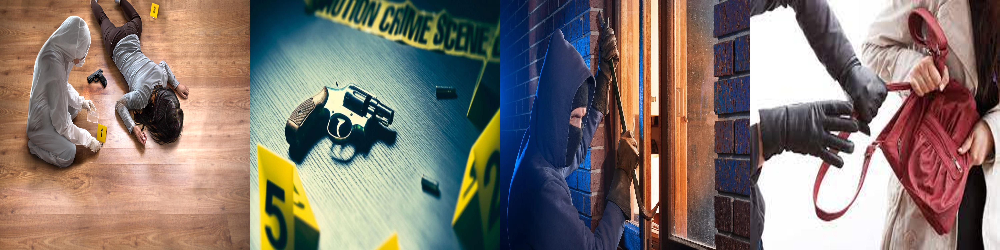

In [2]:
from PIL import Image
from IPython.display import display

# Open images and resize them to the same size (200x200 pixels in this example)
image1 = Image.open("./C1.png").resize((1500, 1500))
image2 = Image.open("./C2.jpg").resize((1500, 1500))
image3 = Image.open("./C3.webp").resize((1500, 1500))
image4 = Image.open("./C5.jpeg").resize((1500, 1500))
# image5 = Image.open("./images/C5.jpeg").resize((800, 800))
# image6 = Image.open("./images/image6.png").resize((800, 800))
# image7 = Image.open("./images/image7.png").resize((800, 800))
# image8 = Image.open("./images/image8.png").resize((800, 800))

# Create a new image with the dimensions of a 2x4 grid of images
width, height = image1.size
total_width = width * 4
total_height = height * 1
collage_image = Image.new('RGB', (total_width, total_height))

# Paste the images into the collage image
collage_image.paste(im=image1, box=(0, 0))
collage_image.paste(im=image2, box=(width, 0))
collage_image.paste(im=image3, box=(width*2, 0))
collage_image.paste(im=image4, box=(width*3, 0))
# collage_image.paste(im=image5, box=(0, height))
# collage_image.paste(im=image6, box=(width, height))
# collage_image.paste(im=image7, box=(width*2, height))
# collage_image.paste(im=image8, box=(width*3, height))

# Display the collage image in the notebook
display(collage_image)

## GENDER DISTRUBUTION IN CRIME

Metropolitan Police Department data which had more data on age and race along with other information. We looked into finding correlations between age and crime along with crime. When we looked into the map, we found that although most of the crimes are being committed by men, there are a fair bit of incidents which are being committed by female.


In [3]:
import folium
import pandas as pd

# Load the data from the Excel file
df = pd.read_excel("2022 adult arrests for open data.xlsx")

# Remove any rows with missing or invalid latitude or longitude values
df = df.dropna(subset=["Arrest Latitude", "Arrest Longitude"])

# Create a map centered on the median latitude and longitude of the data
median_lat = df["Arrest Latitude"].median()
median_lon = df["Arrest Longitude"].median()
m = folium.Map(location=[median_lat, median_lon], zoom_start=12)

numMales = len(df[df["Defendant Sex"] == "MALE"])
numFemales = len(df[df["Defendant Sex"] == "FEMALE"])

# Add circle markers for male and female arrestees
for idx, row in df.iterrows():
    color = "blue" if row["Defendant Sex"] == "MALE" else "red"
    folium.CircleMarker(location=[row["Arrest Latitude"], row["Arrest Longitude"]], 
                        radius=2, 
                        color=color,
                        fill=True,
                        fill_color=color).add_to(m)

# Add a tile layer to the map
m.add_child(folium.TileLayer('cartodbpositron'))

# Define the color scheme for the legend
colors = {'MALE': 'blue', 'FEMALE': 'red'}

# Add a legend control to the map
legend_html = '<div style="position:fixed; bottom:50px; left:50px; z-index:9999; font-size:14px; background-color:white; padding:10px; border-radius:5px;">'
legend_html += '<p style="margin-top:0px; margin-bottom:10px;">Arrestees by Sex:</p>'
for sex, color in colors.items():
    legend_html += f'<p style="margin:0px;"><i class="fa fa-circle fa-1x" style="color:{color};"></i>&nbsp;&nbsp;{sex}</p>'
legend_html += '</div>'
m.get_root().html.add_child(folium.Element(legend_html))

# Add information to the map
info_html = '<div style="position:fixed; bottom:50px; right:50px; z-index:9999; font-size:14px; background-color:white; padding:10px; border-radius:5px;">'
info_html += '<p style="margin-top:0px; margin-bottom:10px;">2022 Adult Arrests for Open Data</p>'
info_html += f'<p style="margin:0px;">Male: {numMales} incidents </p>'
info_html += f'<p style="margin:0px;">Female: {numFemales} incidents </p>'
info_html += '</div>'
m.get_root().html.add_child(folium.Element(info_html))

# Display the map
m


## CRIME RATE BASED ON AGE RANGE

we looked to find the relations between Age and Crime. As we had discussed earlier in our older analysis and previous graphs, the age range which is most affected are the young adults. We also had seen that the age range had most of the people who were below the poverty level. The same is the case with crime as well, there seems to be young adults who have committed crime

As we had a similar graph previously, we can see that the crime overall and within the age range 20 to 30 has shown significant improvement. All the effort which has been invested is good and it is paying off.


In [4]:
import folium
import pandas as pd

# Load the data from the Excel file
df = pd.read_excel("2022 adult arrests for open data.xlsx")

# Remove any rows with missing or invalid latitude or longitude values
df = df.dropna(subset=["Arrest Latitude", "Arrest Longitude"])

# Create a map centered on the median latitude and longitude of the data
median_lat = df["Arrest Latitude"].median()
median_lon = df["Arrest Longitude"].median()
m = folium.Map(location=[median_lat, median_lon], zoom_start=12)

    
# Define colors for different age ranges
ageCount = {"Under 18": 0, "18-29": 0, "30-39": 0, "40-49": 0, "50+": 0}

# Add circle markers for each row in the dataframe
for idx, row in df.iterrows():
    # Get the color for the age range
#     age_color = color_dict.get(row["Age"], "black")
    if(row["Age"] < 18):
        age_color = "green"
        ageCount["Under 18"] += 1
    elif(row["Age"] < 29):
        age_color = "yellow"
        ageCount["18-29"] += 1
    elif(row["Age"] < 39):
        age_color = "voilet"
        ageCount["30-39"] += 1
    elif(row["Age"] < 49):
        age_color = "cyan"
        ageCount["40-49"] += 1
    else:
        age_color = "red"
        ageCount["50+"] += 1
        
    # Get the color for the defendant race
#     race_color = "white" if row["Defendant Race"] == "UNKNOWN" else "black"
    
    # Create the popup content for the circle marker
    popup_content = f"Arrest Category: {row['Arrest Category']}<br>Age: {row['Age']}<br>Defendant Race: {row['Defendant Race']}"
    
    # Create the circle marker with the appropriate color and popup
    folium.CircleMarker(location=[row["Arrest Latitude"], row["Arrest Longitude"]], 
                        radius=2, 
                        color=age_color,
                        fill=True,
                        fill_opacity=0.7,
                        popup=popup_content).add_to(m)

# Add a tile layer to the map
m.add_child(folium.TileLayer('cartodbpositron'))

# Add a legend to the map for the age ranges
legend_html = '''
      <div style="position:fixed; bottom:50px; left:50px; z-index:9999; font-size:14px; background-color:white; padding:10px; border-radius:5px;">&nbsp; Age Range<br> 
      &nbsp;<i class="fa fa-circle" style="color:green"></i>&nbsp; Under 18 &nbsp;<br>
      &nbsp;<i class="fa fa-circle" style="color:yellow"></i>&nbsp; 18-29 &nbsp;<br>
      &nbsp;<i class="fa fa-circle" style="color:voilet"></i>&nbsp; 30-39 &nbsp;<br>
      &nbsp;<i class="fa fa-circle" style="color:cyan"></i>&nbsp; 40-49 &nbsp;<br>
      &nbsp;<i class="fa fa-circle" style="color:red"></i>&nbsp; 50+ &nbsp;
      </div>
     '''
m.get_root().html.add_child(folium.Element(legend_html))

# Add information to the map
info_html = '<div style="position:fixed; bottom:50px; right:50px; z-index:9999; font-size:14px; background-color:white; padding:10px; border-radius:5px;">'
info_html += '<p style="margin-top:0px; margin-bottom:10px;">2022 Incident by Age Range</p>'
for age, count in ageCount.items():
    info_html += f'<p style="margin:0px;">{age}: {count} incidents </p>'
info_html += '</div>'
m.get_root().html.add_child(folium.Element(info_html))

# Display the map
m


## CRIME INCIDENTS BY RACE 2018 - 2022



In [5]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import pandas as pd

# Define a list of data file paths and corresponding chart titles
data_paths = ['./Arrests by Year, 2018.csv',
              './Arrests by Year, 2019.csv',
              './Arrests by Year 2020.csv',
              './Arrests by Year 2021.csv',
              './Arrests by Year 2022.csv']

# Define an empty list to store dataframes for all years
dfs = []

# Loop through each data path and read the CSV file into a dataframe
for path in data_paths:
    df = pd.read_csv(path)
    dfs.append(df)

# Concatenate all dataframes into a single dataframe
combined_df = pd.concat(dfs)


lat_min, lat_max = 38.8000, 38.9300
long_min, long_max = -77.0200, -76.9700

combined_df = combined_df[(combined_df['Arrest Latitude'] >= lat_min) & 
                        (combined_df['Arrest Latitude'] <= lat_max) &
                        (combined_df['Arrest Longitude'] >= long_min) & 
                        (combined_df['Arrest Longitude'] <= long_max)]



# Group the data by year and age range and get the count of incidents
grouped_df = combined_df.groupby(['Arrest Year', 'Defendant Race']).size().reset_index(name='Count')

# Combine the age ranges for each year and get the total count of incidents for each age range
grouped_df['Defendant Race'] = grouped_df['Defendant Race'].astype(str)
# grouped_df = grouped_df.groupby(['Age Range']).agg({'Count': 'sum'}).reset_index()

# Create a subplots object with one row and one column
fig = make_subplots(rows=1, cols=1)

# Add a bar trace for the age ranges
# fig.add_trace(go.Bar(x=grouped_df['Age Range'], y=grouped_df['Count']), row=1, col=1)

for year in grouped_df['Arrest Year'].unique():
    year_df = grouped_df[grouped_df['Arrest Year'] == year]
    fig.add_trace(go.Bar(x=year_df['Defendant Race'], y=year_df['Count'], name=str(year)), row=1, col=1)

# Update the layout of the subplots with better x-axis labels
fig.update_layout(title='Crime Incidents by Defendant Race for all Years',
                  xaxis_title='Defendant Race',
                  yaxis_title='Count')

# Show the plot
fig.show()



## CRIME INCIDENTS BY AGE RANGE 2018 - 2022

In [6]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import pandas as pd

# Define a list of data file paths and corresponding chart titles
data_paths = ['./Arrests by Year, 2018.csv',
              './Arrests by Year, 2019.csv',
              './Arrests by Year 2020.csv',
              './Arrests by Year 2021.csv',
              './Arrests by Year 2022.csv']

# Define an empty list to store dataframes for all years
dfs = []

# Loop through each data path and read the CSV file into a dataframe
for path in data_paths:
    df = pd.read_csv(path)
    dfs.append(df)

# Concatenate all dataframes into a single dataframe
combined_df = pd.concat(dfs)

lat_min, lat_max = 38.8000, 38.9300
long_min, long_max = -77.0200, -76.9700

combined_df = combined_df[(combined_df['Arrest Latitude'] >= lat_min) & 
                        (combined_df['Arrest Latitude'] <= lat_max) &
                        (combined_df['Arrest Longitude'] >= long_min) & 
                        (combined_df['Arrest Longitude'] <= long_max)]

# Group the data by year and age range and get the count of incidents
combined_df['Age Range'] = pd.cut(combined_df['Age'], bins=range(0, 100, 10), include_lowest=True)
grouped_df = combined_df.groupby(['Arrest Year', 'Age Range']).size().reset_index(name='Count')

# Combine the age ranges for each year and get the total count of incidents for each age range
grouped_df['Age Range'] = grouped_df['Age Range'].astype(str)
# grouped_df = grouped_df.groupby(['Age Range']).agg({'Count': 'sum'}).reset_index()

# Create a subplots object with one row and one column
fig = make_subplots(rows=1, cols=1)

# Add a bar trace for the age ranges
# fig.add_trace(go.Bar(x=grouped_df['Age Range'], y=grouped_df['Count']), row=1, col=1)

for year in grouped_df['Arrest Year'].unique():
    year_df = grouped_df[grouped_df['Arrest Year'] == year]
    fig.add_trace(go.Bar(x=year_df['Age Range'], y=year_df['Count'], name=str(year)), row=1, col=1)

# Update the layout of the subplots with better x-axis labels
fig.update_layout(title='Crime Incidents by Age Range for all Years',
                  xaxis_title='Age Range',
                  yaxis_title='Count',
                  xaxis = dict(
                      tickmode = 'array',
                      tickvals = ['(-0.001, 10.0]', '(10.0, 20.0]', '(20.0, 30.0]', '(30.0, 40.0]', '(40.0, 50.0]', '(50.0, 60.0]', '(60.0, 70.0]', '(70.0, 80.0]', '(80.0, 90.0]', '(90.0, 100.0]'],
                      ticktext = ['0-10', '10-20', '20-30', '30-40', '40-50', '50-60', '60-70', '70-80', '80-90', '90+']
                  ))

# Show the plot
fig.show()

